In [4]:
import pandas as pd

In [5]:
pd.read_csv(r"C:\Users\shrut\Downloads\Breast Cancer METABRIC(in).csv")

,Patient ID,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,...,Overall Survival Status,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,Sex,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,MB-0000,75.65,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,NaN,No,claudin-low,1.0,Positve,...,Living,Negative,Yes,138.65,Not Recurred,Female,ER-/HER2-,22.0,2.0,Living
1,MB-0002,43.19,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,High,No,LumA,1.0,Positve,...,Living,Positive,Yes,83.52,Not Recurred,Female,ER+/HER2- High Prolif,10.0,1.0,Living
2,MB-0005,48.87,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,High,Yes,LumB,1.0,Positve,...,Deceased,Positive,No,151.28,Recurred,Female,NaN,15.0,2.0,Died of Disease
3,MB-0006,47.68,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,...,Living,Positive,Yes,162.76,Not Recurred,Female,NaN,25.0,2.0,Living
4,MB-0008,76.97,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,1.0,Positve,...,Deceased,Positive,Yes,18.55,Recurred,Female,ER+/HER2- High Prolif,40.0,2.0,Died of Disease
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2504,MTS-T2428,70.05,NaN,Breast Cancer,Invasive Breast Carcinoma,NaN,NaN,NaN,1.0,Positve,...,NaN,NaN,NaN,4.93,Recurred,Female,NaN,27.0,1.0,NaN
2505,MTS-T2429,63.60,NaN,Breast Cancer,Invasive Breast Carcinoma,NaN,NaN,NaN,1.0,Positve,...,NaN,NaN,NaN,16.18,Recurred,Female,NaN,28.0,2.0,NaN
2506,MTS-T2430,NaN,NaN,Breast Cancer,Invasive Breast Carcinoma,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Female,NaN,NaN,0.0,NaN
2507,MTS-T2431,NaN,NaN,Breast Cancer,Invasive Breast Carcinoma,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Female,NaN,NaN,0.0,NaN


The dataset contains over 2500 rows and 34 columns. The dataset contains numeric and categorical columns. Our objective is to create a model to predict the Mortality Risk.

In [6]:
breast_cancer_df = pd.read_csv(r"C:\Users\shrut\Downloads\Breast Cancer METABRIC(in).csv")
breast_cancer_df.head()

,Patient ID,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,...,Overall Survival Status,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,Sex,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,MB-0000,75.65,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,NaN,No,claudin-low,1.0,Positve,...,Living,Negative,Yes,138.65,Not Recurred,Female,ER-/HER2-,22.0,2.0,Living
1,MB-0002,43.19,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,High,No,LumA,1.0,Positve,...,Living,Positive,Yes,83.52,Not Recurred,Female,ER+/HER2- High Prolif,10.0,1.0,Living
2,MB-0005,48.87,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,High,Yes,LumB,1.0,Positve,...,Deceased,Positive,No,151.28,Recurred,Female,NaN,15.0,2.0,Died of Disease
3,MB-0006,47.68,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,...,Living,Positive,Yes,162.76,Not Recurred,Female,NaN,25.0,2.0,Living
4,MB-0008,76.97,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,1.0,Positve,...,Deceased,Positive,Yes,18.55,Recurred,Female,ER+/HER2- High Prolif,40.0,2.0,Died of Disease


In [7]:
#Let's check the data types and missing values in the various columns.
breast_cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2509 entries, 0 to 2508
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Patient ID                      2509 non-null   object 
 1   Age at Diagnosis                2498 non-null   float64
 2   Type of Breast Surgery          1955 non-null   object 
 3   Cancer Type                     2509 non-null   object 
 4   Cancer Type Detailed            2509 non-null   object 
 5   Cellularity                     1917 non-null   object 
 6   Chemotherapy                    1980 non-null   object 
 7   Pam50 + Claudin-low subtype     1980 non-null   object 
 8   Cohort                          2498 non-null   float64
 9   ER status measured by IHC       2426 non-null   object 
 10  ER Status                       2469 non-null   object 
 11  Neoplasm Histologic Grade       2388 non-null   float64
 12  HER2 status measured by SNP6    19

In [8]:
breast_cancer_df.dropna(subset=['Overall Survival (Months)', 'Overall Survival Status'], inplace=True)
breast_cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1981 entries, 0 to 1984
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Patient ID                      1981 non-null   object 
 1   Age at Diagnosis                1981 non-null   float64
 2   Type of Breast Surgery          1955 non-null   object 
 3   Cancer Type                     1981 non-null   object 
 4   Cancer Type Detailed            1981 non-null   object 
 5   Cellularity                     1917 non-null   object 
 6   Chemotherapy                    1980 non-null   object 
 7   Pam50 + Claudin-low subtype     1980 non-null   object 
 8   Cohort                          1981 non-null   float64
 9   ER status measured by IHC       1938 non-null   object 
 10  ER Status                       1981 non-null   object 
 11  Neoplasm Histologic Grade       1893 non-null   float64
 12  HER2 status measured by SNP6    1980 no

Exploratory Data Analysis and Visualization
Before training a machine learning model, its always a good idea to explore the distributions of various columns and see how they are related to the target column. Let's explore and visualize the data using the Plotly, Matplotlib and Seaborn libraries

In [9]:
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [11]:
import plotly.express as px
fig=px.histogram(breast_cancer_df, x='Age at Diagnosis', title='Age at Diagnosis vs. Survival Status', color='Overall Survival Status')
fig.update_layout(bargap=0.1)
fig.show()

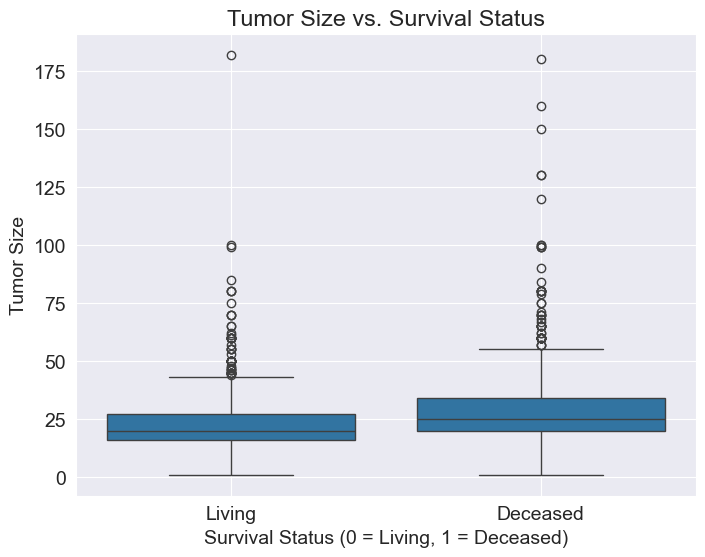

In [12]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='Overall Survival Status', y='Tumor Size', data=breast_cancer_df)
plt.title('Tumor Size vs. Survival Status')
plt.xlabel('Survival Status (0 = Living, 1 = Deceased)')
plt.ylabel('Tumor Size')
plt.grid(True)
plt.show()

In [238]:
import plotly.express as px
fig=px.histogram(breast_cancer_df, x='Tumor Stage', title='Tumor Stage vs. Survival Status', color='Overall Survival Status')
fig.update_layout(bargap=0.1)
fig.show()

In [13]:
import plotly.express as px

fig = px.scatter(breast_cancer_df, x='Tumor Size', y='Overall Survival (Months)', color='Chemotherapy',
                 title='Tumor Size vs. Overall Survival',
                 labels={'Tumor Size': 'Tumor Size', 'Overall Survival (Months)': 'Overall Survival (Months)'},
                 template='plotly_white')

fig.show()

In [14]:
import plotly.express as px
fig=px.histogram(breast_cancer_df, x='Chemotherapy', title='Chemotherapy vs. Survival Status', color='Overall Survival Status')
fig.update_layout(bargap=0.1)
fig.show()

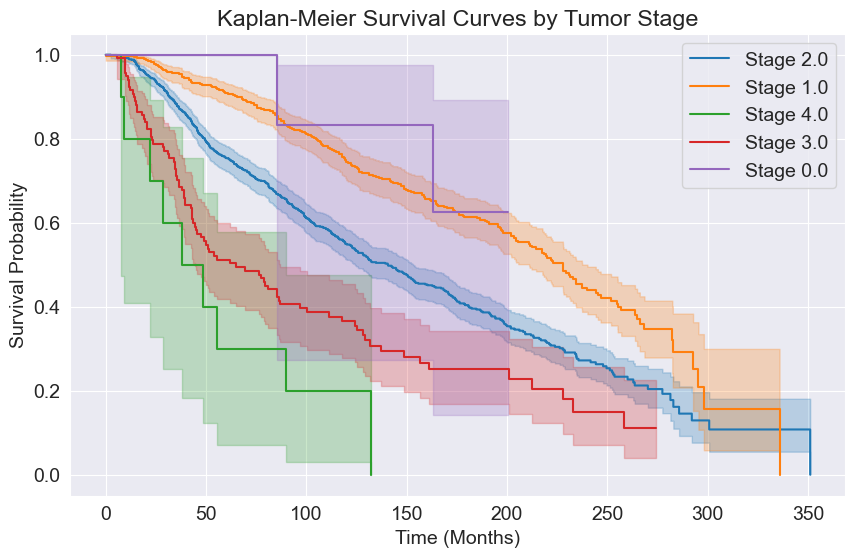

In [15]:
import seaborn as sns 
import numpy as np
from lifelines import KaplanMeierFitter
import matplotlib.pyplot as plt

# Copy cleaned dataframe (assuming it's already filtered)
df = breast_cancer_df.copy()

# Convert Overall Survival Status to binary
df['Overall Survival Status'] = df['Overall Survival Status'].map({'Deceased': 1, 'Living': 0})

# Initialize figure
plt.figure(figsize=(10, 6))

# Loop through unique tumor stages and plot KM curves
kmf = KaplanMeierFitter()
for stage in df['Tumor Stage'].dropna().unique():  # Drop NaNs from 'Tumor Stage'
    subset = df[df['Tumor Stage'] == stage]
    kmf.fit(subset['Overall Survival (Months)'], event_observed=subset['Overall Survival Status'], label=f'Stage {stage}')
    kmf.plot_survival_function()

plt.title('Kaplan-Meier Survival Curves by Tumor Stage')
plt.xlabel('Time (Months)')
plt.ylabel('Survival Probability')
plt.legend()
plt.grid(True)
plt.show()

In [16]:
# Drop unnecessary columns and store in breast_cancer1
breast_cancer1_df = df.drop(columns=["Sex", "Patient ID","Overall Survival Status"])

# Check if it worked
print(breast_cancer1_df.head())  # View first few rows
print(breast_cancer1_df.columns)  # Confirm columns are removed


   Age at Diagnosis Type of Breast Surgery    Cancer Type  \
0             75.65             Mastectomy  Breast Cancer   
1             43.19      Breast Conserving  Breast Cancer   
2             48.87             Mastectomy  Breast Cancer   
3             47.68             Mastectomy  Breast Cancer   
4             76.97             Mastectomy  Breast Cancer   

                        Cancer Type Detailed Cellularity Chemotherapy  \
0           Breast Invasive Ductal Carcinoma         NaN           No   
1           Breast Invasive Ductal Carcinoma        High           No   
2           Breast Invasive Ductal Carcinoma        High          Yes   
3  Breast Mixed Ductal and Lobular Carcinoma    Moderate          Yes   
4  Breast Mixed Ductal and Lobular Carcinoma        High          Yes   

  Pam50 + Claudin-low subtype  Cohort ER status measured by IHC ER Status  \
0                 claudin-low     1.0                   Positve  Positive   
1                        LumA     1.0   

In [17]:
#When working with massive datasets containing millions of rows, it's a good idea to work with a sample initially, to quickly set up your model training notebook. If you'd like to work with a sample, just set the value of use_sample to True.
use_sample = False

In [18]:
sample_fraction = 0.1

In [19]:
if use_sample:
    breast_cancer1_df = raw_df.sample(frac=sample_fraction).copy()

Training, Validation and Test Sets
While building real-world machine learning models, it is quite common to split the dataset into three parts:

Training set - used to train the model, i.e., compute the loss and adjust the model's weights using an optimization technique.

Validation set - used to evaluate the model during training, tune model hyperparameters (optimization technique, regularization etc.), and pick the best version of the model. Picking a good validation set is essential for training models that generalize well. Learn more here.

Test set - used to compare different models or approaches and report the model's final accuracy. For many datasets, test sets are provided separately. The test set should reflect the kind of data the model will encounter in the real-world, as closely as feasible.

In [20]:
from sklearn.model_selection import train_test_split

In [21]:
train_val_df, test_df = train_test_split(breast_cancer1_df, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

In [22]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (1188, 31)
val_df.shape : (396, 31)
test_df.shape : (397, 31)


In [23]:
# Sort dataset by survival time
breast_cancer1_df = breast_cancer1_df.sort_values(by='Overall Survival (Months)')

# Split by time periods (e.g., 70% oldest, 15% middle, 15% newest)
train_index = int(0.7 * len(breast_cancer1_df))
val_index = int(0.85 * len(breast_cancer1_df))

train_df = breast_cancer1_df.iloc[:train_index]  # First 70%
val_df = breast_cancer1_df.iloc[train_index:val_index]  # Next 15%
test_df = breast_cancer1_df.iloc[val_index:]  # Last 15%

print(f"Total dataset size: {len(breast_cancer1_df)}")
print(f"Training set size: {len(train_df)} ({len(train_df)/len(breast_cancer1_df)*100:.2f}%)")
print(f"Validation set size: {len(val_df)} ({len(val_df)/len(breast_cancer1_df)*100:.2f}%)")
print(f"Test set size: {len(test_df)} ({len(test_df)/len(breast_cancer1_df)*100:.2f}%)")

Total dataset size: 1981
Training set size: 1386 (69.96%)
Validation set size: 297 (14.99%)
Test set size: 298 (15.04%)


In [24]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (1386, 31)
val_df.shape : (297, 31)
test_df.shape : (298, 31)


In [27]:
pd.set_option('display.max_columns', None)  # Show all columns
print(train_df.head())  # Display first few rows


      Age at Diagnosis Type of Breast Surgery    Cancer Type  \
1081             69.68             Mastectomy  Breast Cancer   
1786             61.72      Breast Conserving  Breast Cancer   
1295             74.53      Breast Conserving  Breast Cancer   
1807             45.35      Breast Conserving  Breast Cancer   
581              47.03             Mastectomy  Breast Cancer   

                           Cancer Type Detailed Cellularity Chemotherapy  \
1081           Breast Invasive Ductal Carcinoma        High           No   
1786           Breast Invasive Ductal Carcinoma    Moderate           No   
1295           Breast Invasive Ductal Carcinoma    Moderate           No   
1807           Breast Invasive Ductal Carcinoma    Moderate           No   
581   Breast Mixed Ductal and Lobular Carcinoma    Moderate           No   

     Pam50 + Claudin-low subtype  Cohort ER status measured by IHC ER Status  \
1081                       Basal     3.0                       NaN  Negative  

In [28]:
# Load the dataset
breast_cancer1_df = breast_cancer1_df.copy()  # Ensure modifications don't affect the original

# ✅ Create the 10-year mortality column BEFORE splitting
breast_cancer1_df['10_Year_Mortality'] = (breast_cancer1_df['Overall Survival (Months)'] < 120).astype(int)

# ✅ Now perform train-test split with stratification
train_df, temp_df = train_test_split(
    breast_cancer1_df, 
    test_size=0.3, 
    stratify=breast_cancer1_df['10_Year_Mortality'],  # No more KeyError
    random_state=42
)

# ✅ Split temp into validation and test sets
val_df, test_df = train_test_split(
    temp_df, 
    test_size=0.5, 
    stratify=temp_df['10_Year_Mortality'],  
    random_state=42
)

# Print class distribution
print("Class distribution in training set:\n", train_df['10_Year_Mortality'].value_counts())
print("Class distribution in validation set:\n", val_df['10_Year_Mortality'].value_counts())
print("Class distribution in test set:\n", test_df['10_Year_Mortality'].value_counts())


Class distribution in training set:
 10_Year_Mortality
1    719
0    667
Name: count, dtype: int64
Class distribution in validation set:
 10_Year_Mortality
1    154
0    143
Name: count, dtype: int64
Class distribution in test set:
 10_Year_Mortality
1    154
0    144
Name: count, dtype: int64


Identifying Input and Target Columns
Often, not all the columns in a dataset are useful for training a model. In the current dataset, we can ignore the 10_Year_Mortality column and Overall Survival (Months) , since we only want to weather conditions to make a prediction about the mortality risk.

Let's create a list of input columns, and also identify the target column.

In [29]:
input_cols = train_df.drop(columns=['10_Year_Mortality','Overall Survival (Months)']).columns.tolist()
target_col = '10_Year_Mortality'

In [30]:
print(input_cols)

['Age at Diagnosis', 'Type of Breast Surgery', 'Cancer Type', 'Cancer Type Detailed', 'Cellularity', 'Chemotherapy', 'Pam50 + Claudin-low subtype', 'Cohort', 'ER status measured by IHC', 'ER Status', 'Neoplasm Histologic Grade', 'HER2 status measured by SNP6', 'HER2 Status', 'Tumor Other Histologic Subtype', 'Hormone Therapy', 'Inferred Menopausal State', 'Integrative Cluster', 'Primary Tumor Laterality', 'Lymph nodes examined positive', 'Mutation Count', 'Nottingham prognostic index', 'Oncotree Code', 'PR Status', 'Radio Therapy', 'Relapse Free Status (Months)', 'Relapse Free Status', '3-Gene classifier subtype', 'Tumor Size', 'Tumor Stage', "Patient's Vital Status"]


In [31]:
target_col

'10_Year_Mortality'

We can now create inputs and targets for the training, validation and test sets for further processing and model training.

In [32]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

In [33]:
val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_col].copy()

In [34]:
test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [35]:
train_inputs

,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
1081,69.68,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,High,No,Basal,3.0,NaN,Negative,3.0,Neutral,Negative,Ductal/NST,No,Post,9,Right,0.0,9.0,4.0540,IDC,Negative,No,85.26,Recurred,ER-/HER2-,27.0,2.0,Living
1786,61.72,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,No,LumB,4.0,Positve,Positive,1.0,Neutral,Negative,Ductal/NST,Yes,Post,8,Left,1.0,11.0,3.0520,IDC,Positive,Yes,87.34,Not Recurred,ER+/HER2- High Prolif,26.0,NaN,Living
1295,74.53,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,No,Basal,3.0,Negative,Negative,2.0,Neutral,Negative,Ductal/NST,No,Post,10,Left,0.0,5.0,3.0280,IDC,Negative,Yes,208.42,Not Recurred,ER-/HER2-,14.0,1.0,Died of Other Causes
1807,45.35,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,No,LumB,4.0,Positve,Positive,2.0,Neutral,Negative,Ductal/NST,No,Pre,9,Left,0.0,6.0,3.0380,IDC,Positive,Yes,106.45,Not Recurred,ER+/HER2- High Prolif,19.0,NaN,Living
581,47.03,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,No,LumA,2.0,Positve,Positive,2.0,Neutral,Negative,Mixed,No,Pre,8,Left,0.0,8.0,3.0500,MDLC,Positive,No,12.86,Recurred,ER+/HER2- High Prolif,25.0,1.0,Living
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1339,55.53,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,No,LumA,3.0,Positve,Positive,1.0,Neutral,Negative,Ductal/NST,No,Post,8,Right,0.0,7.0,2.0300,IDC,Positive,Yes,17.60,Recurred,ER+/HER2- Low Prolif,15.0,1.0,Living
260,39.86,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,High,Yes,Basal,1.0,Negative,Negative,3.0,Neutral,Negative,Ductal/NST,Yes,Pre,10,Right,0.0,1.0,4.0360,IDC,Negative,Yes,46.64,Recurred,ER-/HER2-,18.0,1.0,Died of Disease
1663,38.58,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,No,Basal,5.0,Negative,Negative,3.0,Neutral,Negative,Ductal/NST,No,Pre,10,Left,8.0,6.0,6.0640,IDC,Negative,No,17.53,Recurred,ER-/HER2-,32.0,NaN,Died of Disease
514,56.47,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,9,Left,15.0,5.0,6.0460,IDC,Negative,Yes,67.30,Recurred,ER+/HER2- High Prolif,23.0,2.0,Died of Disease


In [36]:
train_targets

1081    0
1786    1
1295    0
1807    1
581     1
       ..
1339    0
260     1
1663    1
514     1
1903    0
Name: 10_Year_Mortality, Length: 1386, dtype: int64

In [37]:
import numpy as np

In [38]:
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [39]:
train_inputs[numeric_cols].describe()

,Age at Diagnosis,Cohort,Neoplasm Histologic Grade,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Relapse Free Status (Months),Tumor Size,Tumor Stage
count,1386.000000,1386.000000,1320.000000,1332.000000,1299.000000,1385.000000,1386.000000,1371.000000,1023.000000
mean,61.106602,2.619048,2.407576,2.021021,5.704388,3.986924,109.459372,26.231065,1.735093
std,12.969475,1.247339,0.649677,4.032495,4.152568,1.181686,75.695556,15.438215,0.646540
min,21.930000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,51.390000,1.000000,2.000000,0.000000,3.000000,3.042000,42.025000,17.000000,1.000000
50%,61.725000,3.000000,2.000000,0.000000,5.000000,4.040000,100.720000,23.000000,2.000000
75%,70.647500,3.000000,3.000000,2.000000,7.000000,5.040000,165.817500,30.000000,2.000000
max,96.290000,5.000000,3.000000,41.000000,80.000000,6.360000,346.380000,182.000000,4.000000


In [40]:
train_inputs[categorical_cols].nunique()

Type of Breast Surgery             2
Cancer Type                        2
Cancer Type Detailed               8
Cellularity                        3
Chemotherapy                       2
Pam50 + Claudin-low subtype        7
ER status measured by IHC          2
ER Status                          2
HER2 status measured by SNP6       4
HER2 Status                        2
Tumor Other Histologic Subtype     8
Hormone Therapy                    2
Inferred Menopausal State          2
Integrative Cluster               11
Primary Tumor Laterality           2
Oncotree Code                      8
PR Status                          2
Radio Therapy                      2
Relapse Free Status                2
3-Gene classifier subtype          4
Patient's Vital Status             3
dtype: int64

Imputing Missing Numeric Data
Machine learning models can't work with missing numerical data. The process of filling missing values is called imputation.

In [41]:
from sklearn.impute import SimpleImputer

In [42]:
imputer = SimpleImputer(strategy = 'mean')

In [43]:
breast_cancer1_df[numeric_cols].isna().sum()

Age at Diagnosis                   0
Cohort                             0
Neoplasm Histologic Grade         88
Lymph nodes examined positive     76
Mutation Count                   121
Nottingham prognostic index        1
Relapse Free Status (Months)       0
Tumor Size                        26
Tumor Stage                      515
dtype: int64

In [44]:
#These values are spread across the training, test and validation sets. You can also check the no. of missing values individually for train_inputs, val_inputs and test_inputs.
train_inputs[numeric_cols].isna().sum()

Age at Diagnosis                   0
Cohort                             0
Neoplasm Histologic Grade         66
Lymph nodes examined positive     54
Mutation Count                    87
Nottingham prognostic index        1
Relapse Free Status (Months)       0
Tumor Size                        15
Tumor Stage                      363
dtype: int64

In [45]:
#The first step in imputation is to fit the imputer to the data i.e. compute the chosen statistic (e.g. mean) for each column in the dataset.
imputer.fit(breast_cancer1_df[numeric_cols])

SimpleImputer()

In [46]:
#After calling `fit`, the computed statistic for each column is stored in the `statistics_` property of `imputer`.
list(imputer.statistics_)

[np.float64(61.086986370519945),
 np.float64(2.619384149419485),
 np.float64(2.4141574220813524),
 np.float64(2.0010498687664042),
 np.float64(5.697849462365592),
 np.float64(4.0109603636363635),
 np.float64(110.07288743059061),
 np.float64(26.275580562659844),
 np.float64(1.7360163710777625)]

The missing values in the training, test and validation sets can now be filled in using the `transform` method of `imputer`.

In [47]:
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [48]:
train_inputs[numeric_cols].isna().sum()

Age at Diagnosis                 0
Cohort                           0
Neoplasm Histologic Grade        0
Lymph nodes examined positive    0
Mutation Count                   0
Nottingham prognostic index      0
Relapse Free Status (Months)     0
Tumor Size                       0
Tumor Stage                      0
dtype: int64

Scaling Numeric Features
Another good practice is to scale numeric features to a small range of values e.g. (0,1)or (-1,1)
. Scaling numeric features ensures that no particular feature has a disproportionate impact on the model's loss. Optimization algorithms also work better in practice with smaller numbers.

The numeric columns in our dataset have varying ranges.

In [49]:
breast_cancer1_df[numeric_cols].describe()

,Age at Diagnosis,Cohort,Neoplasm Histologic Grade,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Relapse Free Status (Months),Tumor Size,Tumor Stage
count,1981.000000,1981.000000,1893.000000,1905.000000,1860.000000,1980.000000,1981.000000,1955.000000,1466.000000
mean,61.086986,2.619384,2.414157,2.001050,5.697849,4.010960,110.072887,26.275581,1.736016
std,12.949710,1.232353,0.649158,4.079179,4.057693,1.162498,76.309194,15.379858,0.642541
min,21.930000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,51.420000,1.000000,2.000000,0.000000,3.000000,3.044000,41.740000,17.000000,1.000000
50%,61.810000,3.000000,3.000000,0.000000,5.000000,4.041000,100.720000,23.000000,2.000000
75%,70.600000,3.000000,3.000000,2.000000,7.000000,5.040000,167.600000,30.000000,2.000000
max,96.290000,5.000000,3.000000,45.000000,80.000000,6.360000,346.380000,182.000000,4.000000


In [50]:
#Let's use `MinMaxScaler` from `sklearn.preprocessing` to scale values to the $(0,1)$ range.
from sklearn.preprocessing import MinMaxScaler

In [51]:
?MinMaxScaler

Init signature: MinMaxScaler(feature_range=(0, 1), *, copy=True, clip=False)
Docstring:     
Transform features by scaling each feature to a given range.

This estimator scales and translates each feature individually such
that it is in the given range on the training set, e.g. between
zero and one.

The transformation is given by::

    X_std = (X - X.min(axis=0)) / (X.max(axis=0) - X.min(axis=0))
    X_scaled = X_std * (max - min) + min

where min, max = feature_range.

This transformation is often used as an alternative to zero mean,
unit variance scaling.

`MinMaxScaler` doesn't reduce the effect of outliers, but it linearly
scales them down into a fixed range, where the largest occurring data point
corresponds to the maximum value and the smallest one corresponds to the
minimum value. For an example visualization, refer to :ref:`Compare
MinMaxScaler with other scalers <plot_all_scaling_minmax_scaler_section>`.

Read more in the :ref:`User Guide <preprocessing_scaler>`.

Parameters

In [52]:
scaler = MinMaxScaler()

In [53]:
scaler.fit(breast_cancer1_df[numeric_cols])

MinMaxScaler()

In [54]:
print('Minimum:')
list(scaler.data_min_)

Minimum:


[np.float64(21.93),
 np.float64(1.0),
 np.float64(1.0),
 np.float64(0.0),
 np.float64(1.0),
 np.float64(1.0),
 np.float64(0.0),
 np.float64(1.0),
 np.float64(0.0)]

In [55]:
print('Maximum:')
list(scaler.data_max_)

Maximum:


[np.float64(96.29),
 np.float64(5.0),
 np.float64(3.0),
 np.float64(45.0),
 np.float64(80.0),
 np.float64(6.36),
 np.float64(346.38),
 np.float64(182.0),
 np.float64(4.0)]

In [56]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [57]:
train_inputs[numeric_cols].describe()

,Age at Diagnosis,Cohort,Neoplasm Histologic Grade,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Relapse Free Status (Months),Tumor Size,Tumor Stage
count,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000,1386.000000
mean,0.526850,0.404762,0.703945,0.044894,0.059544,0.557265,0.316010,0.139401,0.433834
std,0.174415,0.311835,0.317005,0.087847,0.050886,0.220384,0.218533,0.084831,0.138847
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.396181,0.000000,0.500000,0.000000,0.025316,0.380970,0.121326,0.088398,0.250000
50%,0.535167,0.500000,0.707079,0.022222,0.050633,0.567164,0.290779,0.121547,0.434004
75%,0.655157,0.500000,1.000000,0.044444,0.075949,0.753731,0.478716,0.160221,0.500000
max,1.000000,1.000000,1.000000,0.911111,1.000000,1.000000,1.000000,1.000000,1.000000


Encoding Categorical Data
Since machine learning models can only be trained with numeric data, we need to convert categorical data to numbers. A common technique is to use one-hot encoding for categorical columns.
One hot encoding involves adding a new binary (0/1) column for each unique category of a categorical column.

In [233]:
breast_cancer1_df[categorical_cols].nunique()

Type of Breast Surgery             2
Cancer Type                        2
Cancer Type Detailed               8
Cellularity                        3
Chemotherapy                       2
Pam50 + Claudin-low subtype        7
ER status measured by IHC          2
ER Status                          2
HER2 status measured by SNP6       4
HER2 Status                        2
Tumor Other Histologic Subtype     8
Hormone Therapy                    2
Inferred Menopausal State          2
Integrative Cluster               11
Primary Tumor Laterality           2
Oncotree Code                      8
PR Status                          2
Radio Therapy                      2
Relapse Free Status                2
3-Gene classifier subtype          4
Patient's Vital Status             3
dtype: int64

In [234]:
from sklearn.preprocessing import OneHotEncoder

In [235]:
?OneHotEncoder

Init signature:
OneHotEncoder(
    *,
    categories='auto',
    drop=None,
    sparse_output=True,
    dtype=<class 'numpy.float64'>,
    handle_unknown='error',
    min_frequency=None,
    max_categories=None,
    feature_name_combiner='concat',
)
Docstring:     
Encode categorical features as a one-hot numeric array.

The input to this transformer should be an array-like of integers or
strings, denoting the values taken on by categorical (discrete) features.
The features are encoded using a one-hot (aka 'one-of-K' or 'dummy')
encoding scheme. This creates a binary column for each category and
returns a sparse matrix or dense array (depending on the ``sparse_output``
parameter).

By default, the encoder derives the categories based on the unique values
in each feature. Alternatively, you can also specify the `categories`
manually.

This encoding is needed for feeding categorical data to many scikit-learn
estimators, notably linear models and SVMs with the standard kernels.

Note: a o

In [236]:
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')

In [237]:
encoder.fit(breast_cancer1_df[categorical_cols])

OneHotEncoder(handle_unknown='ignore', sparse_output=False)

In [238]:
encoder.categories_

[array(['Breast Conserving', 'Mastectomy', nan], dtype=object),
 array(['Breast Cancer', 'Breast Sarcoma'], dtype=object),
 array(['Breast', 'Breast Angiosarcoma',
        'Breast Invasive Ductal Carcinoma',
        'Breast Invasive Lobular Carcinoma',
        'Breast Invasive Mixed Mucinous Carcinoma',
        'Breast Mixed Ductal and Lobular Carcinoma',
        'Invasive Breast Carcinoma', 'Metaplastic Breast Cancer'],
       dtype=object),
 array(['High', 'Low', 'Moderate', nan], dtype=object),
 array(['No', 'Yes', nan], dtype=object),
 array(['Basal', 'Her2', 'LumA', 'LumB', 'NC', 'Normal', 'claudin-low',
        nan], dtype=object),
 array(['Negative', 'Positve', nan], dtype=object),
 array(['Negative', 'Positive'], dtype=object),
 array(['Gain', 'Loss', 'Neutral', 'Undef', nan], dtype=object),
 array(['Negative', 'Positive', nan], dtype=object),
 array(['Ductal/NST', 'Lobular', 'Medullary', 'Metaplastic', 'Mixed',
        'Mucinous', 'Other', 'Tubular/ cribriform', nan], dtype=ob

In [239]:
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
print(encoded_cols)

['Type of Breast Surgery_Breast Conserving', 'Type of Breast Surgery_Mastectomy', 'Type of Breast Surgery_nan', 'Cancer Type_Breast Cancer', 'Cancer Type_Breast Sarcoma', 'Cancer Type Detailed_Breast', 'Cancer Type Detailed_Breast Angiosarcoma', 'Cancer Type Detailed_Breast Invasive Ductal Carcinoma', 'Cancer Type Detailed_Breast Invasive Lobular Carcinoma', 'Cancer Type Detailed_Breast Invasive Mixed Mucinous Carcinoma', 'Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma', 'Cancer Type Detailed_Invasive Breast Carcinoma', 'Cancer Type Detailed_Metaplastic Breast Cancer', 'Cellularity_High', 'Cellularity_Low', 'Cellularity_Moderate', 'Cellularity_nan', 'Chemotherapy_No', 'Chemotherapy_Yes', 'Chemotherapy_nan', 'Pam50 + Claudin-low subtype_Basal', 'Pam50 + Claudin-low subtype_Her2', 'Pam50 + Claudin-low subtype_LumA', 'Pam50 + Claudin-low subtype_LumB', 'Pam50 + Claudin-low subtype_NC', 'Pam50 + Claudin-low subtype_Normal', 'Pam50 + Claudin-low subtype_claudin-low', 'Pam50 

In [240]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

In [241]:
pd.set_option('display.max_columns', None)

In [242]:
test_inputs

,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status,Type of Breast Surgery_Breast Conserving,Type of Breast Surgery_Mastectomy,Type of Breast Surgery_nan,Cancer Type_Breast Cancer,Cancer Type_Breast Sarcoma,Cancer Type Detailed_Breast,Cancer Type Detailed_Breast Angiosarcoma,Cancer Type Detailed_Breast Invasive Ductal Carcinoma,Cancer Type Detailed_Breast Invasive Lobular Carcinoma,Cancer Type Detailed_Breast Invasive Mixed Mucinous Carcinoma,Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma,Cancer Type Detailed_Invasive Breast Carcinoma,Cancer Type Detailed_Metaplastic Breast Cancer,Cellularity_High,Cellularity_Low,Cellularity_Moderate,Cellularity_nan,Chemotherapy_No,Chemotherapy_Yes,Chemotherapy_nan,Pam50 + Claudin-low subtype_Basal,Pam50 + Claudin-low subtype_Her2,Pam50 + Claudin-low subtype_LumA,Pam50 + Claudin-low subtype_LumB,Pam50 + Claudin-low subtype_NC,Pam50 + Claudin-low subtype_Normal,Pam50 + Claudin-low subtype_claudin-low,Pam50 + Claudin-low subtype_nan,ER status measured by IHC_Negative,ER status measured by IHC_Positve,ER status measured by IHC_nan,ER Status_Negative,ER Status_Positive,HER2 status measured by SNP6_Gain,HER2 status measured by SNP6_Loss,HER2 status measured by SNP6_Neutral,HER2 status measured by SNP6_Undef,HER2 status measured by SNP6_nan,HER2 Status_Negative,HER2 Status_Positive,HER2 Status_nan,Tumor Other Histologic Subtype_Ductal/NST,Tumor Other Histologic Subtype_Lobular,Tumor Other Histologic Subtype_Medullary,Tumor Other Histologic Subtype_Metaplastic,Tumor Other Histologic Subtype_Mixed,Tumor Other Histologic Subtype_Mucinous,Tumor Other Histologic Subtype_Other,Tumor Other Histologic Subtype_Tubular/ cribriform,Tumor Other Histologic Subtype_nan,Hormone Therapy_No,Hormone Therapy_Yes,Hormone Therapy_nan,Inferred Menopausal State_Post,Inferred Menopausal State_Pre,Inferred Menopausal State_nan,Integrative Cluster_1,Integrative Cluster_10,Integrative Cluster_2,Integrative Cluster_3,Integrative Cluster_4ER+,Integrative Cluster_4ER-,Integrative Cluster_5,Integrative Cluster_6,Integrative Cluster_7,Integrative Cluster_8,Integrative Cluster_9,Integrative Cluster_nan,Primary Tumor Laterality_Left,Primary Tumor Laterality_Right,Primary Tumor Laterality_nan,Oncotree Code_BRCA,Oncotree Code_BREAST,Oncotree Code_IDC,Oncotree Code_ILC,Oncotree Code_IMMC,Oncotree Code_MBC,Oncotree Code_MDLC,Oncotree Code_PBS,PR Status_Negative,PR Status_Positive,PR Status_nan,Radio Therapy_No,Radio Therapy_Yes,Radio Therapy_nan,Relapse Free Status_Not Recurred,Relapse Free Status_Recurred,Relapse Free Status_nan,3-Gene classifier subtype_ER+/HER2- High Prolif,3-Gene classifier subtype_ER+/HER2- Low Prolif,3-Gene classifier subtype_ER-/HER2-,3-Gene classifier subtype_HER2+,3-Gene classifier subtype_nan,Patient's Vital Status_Died of Disease,Patient's Vital Status_Died of Other Causes,Patient's Vital Status_Living,Patient's Vital Status_nan
1842,0.366192,Breast Conserving,Breast Cancer,Breast Invasive Lobular Carcinoma,Low,No,LumA,0.75,Positve,Positive,0.5,Neutral,Negative,Lobular,Yes,Pre,3,Right,0.000000,0.050633,0.378918,ILC,Positive,Yes,0.354033,Not Recurred,ER+/HER2- Low Prolif,0.080110,0.434004,Living,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0

Saving Processed Data to Disk
It can be useful to save processed data to disk, especially for really large datasets, to avoid repeating the preprocessing steps every time you start the Jupyter notebook. The parquet format is a fast and efficient format for saving and loading Pandas dataframes.

In [243]:
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('val_inputs:', val_inputs.shape)
print('val_targets:', val_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (1386, 127)
train_targets: (1386,)
val_inputs: (297, 127)
val_targets: (297,)
test_inputs: (298, 127)
test_targets: (298,)


In [244]:
train_inputs.to_parquet('train_inputs.parquet')
val_inputs.to_parquet('val_inputs.parquet')
test_inputs.to_parquet('test_inputs.parquet')

In [245]:
%%time
pd.DataFrame(train_targets).to_parquet('train_targets.parquet')
pd.DataFrame(val_targets).to_parquet('val_targets.parquet')
pd.DataFrame(test_targets).to_parquet('test_targets.parquet')

CPU times: total: 15.6 ms
Wall time: 14.6 ms


In [246]:
%%time

train_inputs = pd.read_parquet('train_inputs.parquet')
val_inputs = pd.read_parquet('val_inputs.parquet')
test_inputs = pd.read_parquet('test_inputs.parquet')

train_targets = pd.read_parquet('train_targets.parquet')[target_col]
val_targets = pd.read_parquet('val_targets.parquet')[target_col]
test_targets = pd.read_parquet('test_targets.parquet')[target_col]

CPU times: total: 250 ms
Wall time: 251 ms


In [247]:
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('val_inputs:', val_inputs.shape)
print('val_targets:', val_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (1386, 127)
train_targets: (1386,)
val_inputs: (297, 127)
val_targets: (297,)
test_inputs: (298, 127)
test_targets: (298,)


In [248]:
val_inputs

,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status,Type of Breast Surgery_Breast Conserving,Type of Breast Surgery_Mastectomy,Type of Breast Surgery_nan,Cancer Type_Breast Cancer,Cancer Type_Breast Sarcoma,Cancer Type Detailed_Breast,Cancer Type Detailed_Breast Angiosarcoma,Cancer Type Detailed_Breast Invasive Ductal Carcinoma,Cancer Type Detailed_Breast Invasive Lobular Carcinoma,Cancer Type Detailed_Breast Invasive Mixed Mucinous Carcinoma,Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma,Cancer Type Detailed_Invasive Breast Carcinoma,Cancer Type Detailed_Metaplastic Breast Cancer,Cellularity_High,Cellularity_Low,Cellularity_Moderate,Cellularity_nan,Chemotherapy_No,Chemotherapy_Yes,Chemotherapy_nan,Pam50 + Claudin-low subtype_Basal,Pam50 + Claudin-low subtype_Her2,Pam50 + Claudin-low subtype_LumA,Pam50 + Claudin-low subtype_LumB,Pam50 + Claudin-low subtype_NC,Pam50 + Claudin-low subtype_Normal,Pam50 + Claudin-low subtype_claudin-low,Pam50 + Claudin-low subtype_nan,ER status measured by IHC_Negative,ER status measured by IHC_Positve,ER status measured by IHC_nan,ER Status_Negative,ER Status_Positive,HER2 status measured by SNP6_Gain,HER2 status measured by SNP6_Loss,HER2 status measured by SNP6_Neutral,HER2 status measured by SNP6_Undef,HER2 status measured by SNP6_nan,HER2 Status_Negative,HER2 Status_Positive,HER2 Status_nan,Tumor Other Histologic Subtype_Ductal/NST,Tumor Other Histologic Subtype_Lobular,Tumor Other Histologic Subtype_Medullary,Tumor Other Histologic Subtype_Metaplastic,Tumor Other Histologic Subtype_Mixed,Tumor Other Histologic Subtype_Mucinous,Tumor Other Histologic Subtype_Other,Tumor Other Histologic Subtype_Tubular/ cribriform,Tumor Other Histologic Subtype_nan,Hormone Therapy_No,Hormone Therapy_Yes,Hormone Therapy_nan,Inferred Menopausal State_Post,Inferred Menopausal State_Pre,Inferred Menopausal State_nan,Integrative Cluster_1,Integrative Cluster_10,Integrative Cluster_2,Integrative Cluster_3,Integrative Cluster_4ER+,Integrative Cluster_4ER-,Integrative Cluster_5,Integrative Cluster_6,Integrative Cluster_7,Integrative Cluster_8,Integrative Cluster_9,Integrative Cluster_nan,Primary Tumor Laterality_Left,Primary Tumor Laterality_Right,Primary Tumor Laterality_nan,Oncotree Code_BRCA,Oncotree Code_BREAST,Oncotree Code_IDC,Oncotree Code_ILC,Oncotree Code_IMMC,Oncotree Code_MBC,Oncotree Code_MDLC,Oncotree Code_PBS,PR Status_Negative,PR Status_Positive,PR Status_nan,Radio Therapy_No,Radio Therapy_Yes,Radio Therapy_nan,Relapse Free Status_Not Recurred,Relapse Free Status_Recurred,Relapse Free Status_nan,3-Gene classifier subtype_ER+/HER2- High Prolif,3-Gene classifier subtype_ER+/HER2- Low Prolif,3-Gene classifier subtype_ER-/HER2-,3-Gene classifier subtype_HER2+,3-Gene classifier subtype_nan,Patient's Vital Status_Died of Disease,Patient's Vital Status_Died of Other Causes,Patient's Vital Status_Living,Patient's Vital Status_nan
1652,0.520307,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,High,No,Basal,1.00,Positve,Negative,0.5,Neutral,Negative,Ductal/NST,No,Post,10,Right,0.000000,0.151899,0.379478,IDC,Negative,No,0.652145,Not Recurred,ER-/HER2-,0.088398,0.434004,Living,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1

In [230]:
val_targets

1652    0
160     1
1418    0
497     1
1335    1
       ..
888     0
1558    1
1812    1
558     0
863     0
Name: 10_Year_Mortality, Length: 297, dtype: int64

In [ ]:
## Training a Logistic Regression Model

Logistic regression is a commonly used technique for solving binary classification problems. In a logistic regression model: 

- we take linear combination (or weighted sum of the input features) 
- we apply the sigmoid function to the result to obtain a number between 0 and 1
- this number represents the probability of the input being classified as "Yes"
- instead of RMSE, the cross entropy loss function is used to evaluate the results
To train a logistic regression model, we can use the `LogisticRegression` class from Scikit-learn.

In [332]:
from sklearn.linear_model import LogisticRegression

In [333]:
?LogisticRegression

Init signature:
LogisticRegression(
    penalty='l2',
    *,
    dual=False,
    tol=0.0001,
    C=1.0,
    fit_intercept=True,
    intercept_scaling=1,
    class_weight=None,
    random_state=None,
    solver='lbfgs',
    max_iter=100,
    multi_class='deprecated',
    verbose=0,
    warm_start=False,
    n_jobs=None,
    l1_ratio=None,
)
Docstring:     
Logistic Regression (aka logit, MaxEnt) classifier.

This class implements regularized logistic regression using the
'liblinear' library, 'newton-cg', 'sag', 'saga' and 'lbfgs' solvers. **Note
that regularization is applied by default**. It can handle both dense
and sparse input. Use C-ordered arrays or CSR matrices containing 64-bit
floats for optimal performance; any other input format will be converted
(and copied).

The 'newton-cg', 'sag', and 'lbfgs' solvers support only L2 regularization
with primal formulation, or no regularization. The 'liblinear' solver
supports both L1 and L2 regularization, with a dual formulation only for


In [334]:
model = LogisticRegression(solver='liblinear')

model.fit uses the following workflow for training the model (source):

We initialize a model with random parameters (weights & biases).
We pass some inputs into the model to obtain predictions.
We compare the model's predictions with the actual targets using the loss function.
We use an optimization technique (like least squares, gradient descent etc.) to reduce the loss by adjusting the weights & biases of the model
We repeat steps 1 to 4 till the predictions from the model are good enough.

In [335]:
model.fit(train_inputs[encoded_cols], train_targets)

LogisticRegression(solver='liblinear')

In [336]:
print(encoded_cols)

['Type of Breast Surgery_Breast Conserving', 'Type of Breast Surgery_Mastectomy', 'Type of Breast Surgery_nan', 'Cancer Type_Breast Cancer', 'Cancer Type_Breast Sarcoma', 'Cancer Type Detailed_Breast', 'Cancer Type Detailed_Breast Angiosarcoma', 'Cancer Type Detailed_Breast Invasive Ductal Carcinoma', 'Cancer Type Detailed_Breast Invasive Lobular Carcinoma', 'Cancer Type Detailed_Breast Invasive Mixed Mucinous Carcinoma', 'Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma', 'Cancer Type Detailed_Invasive Breast Carcinoma', 'Cancer Type Detailed_Metaplastic Breast Cancer', 'Cellularity_High', 'Cellularity_Low', 'Cellularity_Moderate', 'Cellularity_nan', 'Chemotherapy_No', 'Chemotherapy_Yes', 'Chemotherapy_nan', 'Pam50 + Claudin-low subtype_Basal', 'Pam50 + Claudin-low subtype_Her2', 'Pam50 + Claudin-low subtype_LumA', 'Pam50 + Claudin-low subtype_LumB', 'Pam50 + Claudin-low subtype_NC', 'Pam50 + Claudin-low subtype_Normal', 'Pam50 + Claudin-low subtype_claudin-low', 'Pam50 

In [337]:
print(model.coef_.tolist())

[[-0.11001692634645904, -0.10760341427665297, 0.0, -0.48772899847128326, 0.3929111316522418, 0.13597540682044504, 0.3929111316522418, -0.30776921468292656, -0.08197784141239535, 0.15606185563485084, -0.01773009255611907, -0.17643764517787522, -0.1958514670974815, -0.13810682901422836, 0.010699196127385076, -0.2842951822204197, 0.0, -0.15920750461916455, 0.4782743401265476, 0.0, 0.39048071597034417, -0.11073264624257433, 0.041726786255117894, 0.0781587471438894, -0.23002285102040576, 0.12865419059028815, 0.02080189281080252, 0.0, 0.17128673461899885, 0.47945228597821826, 0.0, 0.21329797029197634, -0.30811583711126606, 0.419494370692684, 0.2701782968023104, -0.2723482856948307, -0.09825754629267876, 0.0, 0.19099176814035632, 0.12807506736713997, 0.0, 0.41177563182622784, -0.08197784141239535, -0.6812106627774467, -0.1958514670974815, -0.01773009255611907, 0.15606185563485084, 0.13597540682044504, -0.038334183731705246, 0.0, -0.06996146510147941, 0.389028300608948, 0.0, 0.2412531036878178

In [263]:
print(model.intercept_)

[0.34165801]


In [338]:
X_train = train_inputs[encoded_cols]
X_val = val_inputs[encoded_cols]
X_test = test_inputs[encoded_cols]

In [339]:
train_preds = model.predict(X_train)

In [340]:
train_preds

array([0, 0, 0, ..., 1, 1, 1], shape=(1386,))

In [341]:
train_targets

1081    0
1786    1
1295    0
1807    1
581     1
       ..
1339    0
260     1
1663    1
514     1
1903    0
Name: 10_Year_Mortality, Length: 1386, dtype: int64

In [342]:
train_probs = model.predict_proba(X_train)
train_probs

array([[0.7946157 , 0.2053843 ],
       [0.77785585, 0.22214415],
       [0.56564639, 0.43435361],
       ...,
       [0.27604444, 0.72395556],
       [0.10458998, 0.89541002],
       [0.28501022, 0.71498978]], shape=(1386, 2))

In [343]:
model.classes_

array([0, 1])

In [344]:
from sklearn.metrics import accuracy_score

In [345]:
accuracy_score(train_targets, train_preds)

0.7049062049062049

In [346]:
from sklearn.metrics import confusion_matrix

In [347]:
confusion_matrix(train_targets, train_preds, normalize='true')

array([[0.74362819, 0.25637181],
       [0.3310153 , 0.6689847 ]])

In [348]:
def predict_and_plot(inputs, targets, name=''):
    preds = model.predict(inputs)
    
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));
    
    return preds

Accuracy: 70.49%


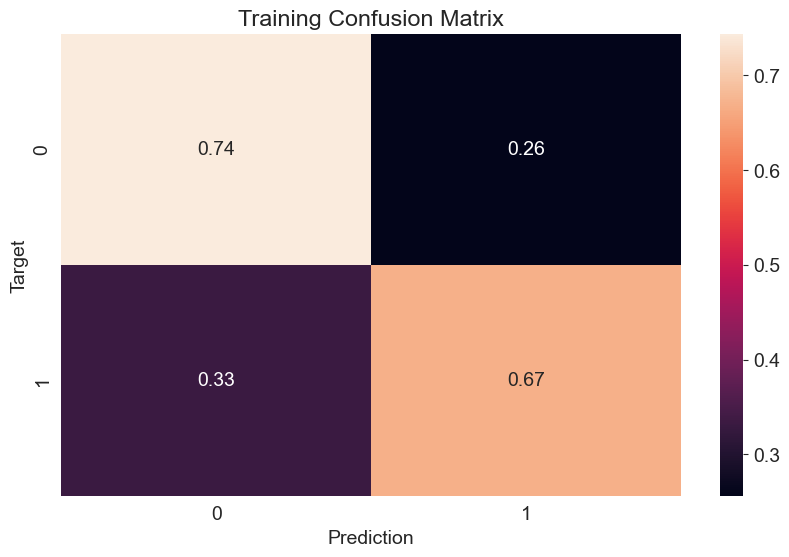

In [350]:
train_preds = predict_and_plot(X_train, train_targets, 'Training')

Accuracy: 63.30%


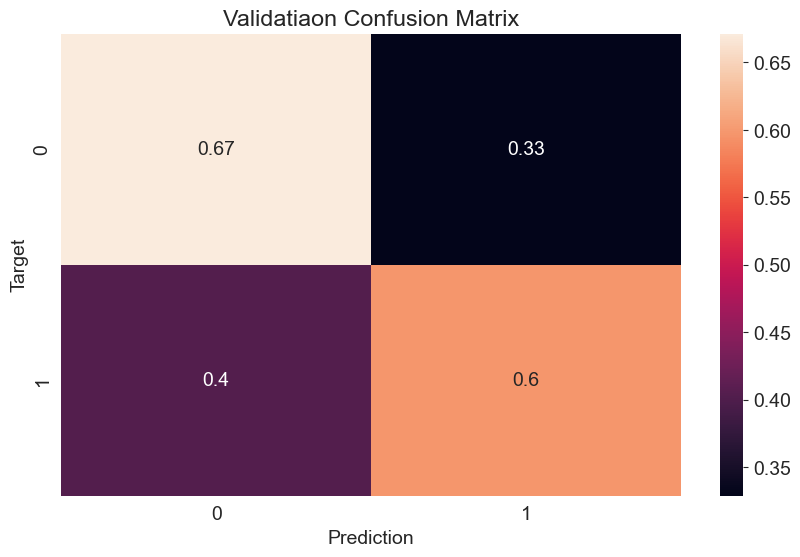

In [351]:
val_preds = predict_and_plot(X_val, val_targets, 'Validatiaon')

Accuracy: 68.12%


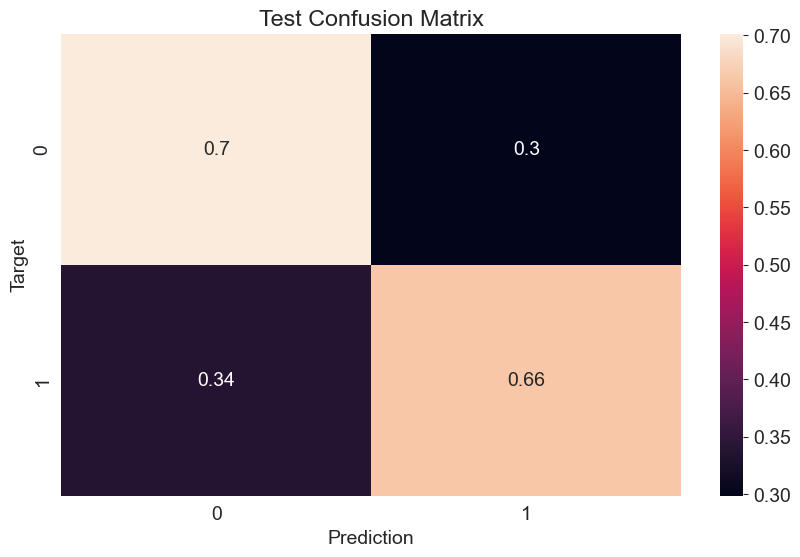

In [352]:
test_preds = predict_and_plot(X_test, test_targets, 'Test')

In [353]:
def random_guess(inputs):
    return np.random.choice([0,1], len(inputs))

In [354]:
def all_no(inputs):
    return np.full(len(inputs), 0)

In [358]:
accuracy_score(test_targets, random_guess(X_test))


0.47651006711409394

In [357]:
accuracy_score(test_targets, all_no(X_test))

0.48322147651006714

Making Predictions on a Single Input
Once the model has been trained to a satisfactory accuracy, it can be used to make predictions on new data. Consider the following dictionary containing data collected from the Katherine weather department today.

In [359]:
new_input = {'Patient ID': 'MB-0185',
             'Age at Diagnosis': 27,
             'Type of Breast Surgery': 'Mastectomy',
             'Cancer Type': 'Breast Cancer',
             'Cancer Type Detailed': 'Breast Mixed Ductal and Lobular Carcinoma',
             'Cellularity': 'High',
             'Chemotherapy': 'Yes',
             'Pam50 + Claudin-low subtype': 'LumB',
             'Cohort': 5,
             'ER status measured by IHC': 'Negative',
             'ER Status': 'Negative',
             'Neoplasm Histologic Grade': 3,
             'HER2 status measured by SNP6': 'Neutral',
             'HER2 Status': 'Negative',
             'Tumor Other Histologic Subtype': 'Lobular',
             'Hormone Therapy': 'Yes',
             'Inferred Menopausal State': 'Pre',
             'Integrative Cluster': '4ER+',
             'Primary Tumor Laterality': 'Left',
             'Lymph nodes examined positive': 0,
             'Mutation Count': 3,
             'Nottingham prognostic index': 4.058,
             'Oncotree Code': 'ILC',
             'PR Status' : 'Positive',
             'Radio Therapy': 'Yes',
             'Relapse Free Status (Months)': 162.17,
             'Relapse Free Status': 'Not Recurred',
             '3-Gene classifier subtype': 'ER-/HER2-',
             'Tumor Size': 30,
             'Tumor Stage':2,
             "Patient's Vital Status":'Living'}

In [360]:
new_input_df = pd.DataFrame([new_input])

In [361]:
new_input_df

,Patient ID,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,MB-0185,27,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,5,Negative,Negative,3,Neutral,Negative,Lobular,Yes,Pre,4ER+,Left,0,3,4.058,ILC,Positive,Yes,162.17,Not Recurred,ER-/HER2-,30,2,Living


In [363]:
new_input_df[numeric_cols] = imputer.transform(new_input_df[numeric_cols])
new_input_df[numeric_cols] = scaler.transform(new_input_df[numeric_cols])
new_input_df[encoded_cols] = encoder.transform(new_input_df[categorical_cols])


In [364]:
X_new_input = new_input_df[encoded_cols]
X_new_input

,Type of Breast Surgery_Breast Conserving,Type of Breast Surgery_Mastectomy,Type of Breast Surgery_nan,Cancer Type_Breast Cancer,Cancer Type_Breast Sarcoma,Cancer Type Detailed_Breast,Cancer Type Detailed_Breast Angiosarcoma,Cancer Type Detailed_Breast Invasive Ductal Carcinoma,Cancer Type Detailed_Breast Invasive Lobular Carcinoma,Cancer Type Detailed_Breast Invasive Mixed Mucinous Carcinoma,Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma,Cancer Type Detailed_Invasive Breast Carcinoma,Cancer Type Detailed_Metaplastic Breast Cancer,Cellularity_High,Cellularity_Low,Cellularity_Moderate,Cellularity_nan,Chemotherapy_No,Chemotherapy_Yes,Chemotherapy_nan,Pam50 + Claudin-low subtype_Basal,Pam50 + Claudin-low subtype_Her2,Pam50 + Claudin-low subtype_LumA,Pam50 + Claudin-low subtype_LumB,Pam50 + Claudin-low subtype_NC,Pam50 + Claudin-low subtype_Normal,Pam50 + Claudin-low subtype_claudin-low,Pam50 + Claudin-low subtype_nan,ER status measured by IHC_Negative,ER status measured by IHC_Positve,ER status measured by IHC_nan,ER Status_Negative,ER Status_Positive,HER2 status measured by SNP6_Gain,HER2 status measured by SNP6_Loss,HER2 status measured by SNP6_Neutral,HER2 status measured by SNP6_Undef,HER2 status measured by SNP6_nan,HER2 Status_Negative,HER2 Status_Positive,HER2 Status_nan,Tumor Other Histologic Subtype_Ductal/NST,Tumor Other Histologic Subtype_Lobular,Tumor Other Histologic Subtype_Medullary,Tumor Other Histologic Subtype_Metaplastic,Tumor Other Histologic Subtype_Mixed,Tumor Other Histologic Subtype_Mucinous,Tumor Other Histologic Subtype_Other,Tumor Other Histologic Subtype_Tubular/ cribriform,Tumor Other Histologic Subtype_nan,Hormone Therapy_No,Hormone Therapy_Yes,Hormone Therapy_nan,Inferred Menopausal State_Post,Inferred Menopausal State_Pre,Inferred Menopausal State_nan,Integrative Cluster_1,Integrative Cluster_10,Integrative Cluster_2,Integrative Cluster_3,Integrative Cluster_4ER+,Integrative Cluster_4ER-,Integrative Cluster_5,Integrative Cluster_6,Integrative Cluster_7,Integrative Cluster_8,Integrative Cluster_9,Integrative Cluster_nan,Primary Tumor Laterality_Left,Primary Tumor Laterality_Right,Primary Tumor Laterality_nan,Oncotree Code_BRCA,Oncotree Code_BREAST,Oncotree Code_IDC,Oncotree Code_ILC,Oncotree Code_IMMC,Oncotree Code_MBC,Oncotree Code_MDLC,Oncotree Code_PBS,PR Status_Negative,PR Status_Positive,PR Status_nan,Radio Therapy_No,Radio Therapy_Yes,Radio Therapy_nan,Relapse Free Status_Not Recurred,Relapse Free Status_Recurred,Relapse Free Status_nan,3-Gene classifier subtype_ER+/HER2- High Prolif,3-Gene classifier subtype_ER+/HER2- Low Prolif,3-Gene classifier subtype_ER-/HER2-,3-Gene classifier subtype_HER2+,3-Gene classifier subtype_nan,Patient's Vital Status_Died of Disease,Patient's Vital Status_Died of Other Causes,Patient's Vital Status_Living,Patient's Vital Status_nan
0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


In [365]:
prediction = model.predict(X_new_input)[0]

In [366]:
prediction = np.array([0])  # Example array
prediction = int(prediction[0])  # Convert first element
print(prediction)


0


In [367]:
prob = model.predict_proba(X_new_input)[0]

In [368]:
prob

array([0.55709498, 0.44290502])

Training and Visualizing Decision Trees
A decision tree in general parlance represents a hierarchical series of binary decisions.A decision tree in machine learning works in exactly the same way, and except that we let the computer figure out the optimal structure & hierarchy of decisions, instead of coming up with criteria manually.

In [369]:
from sklearn.tree import DecisionTreeClassifier

In [370]:
model = DecisionTreeClassifier(random_state=42)

In [371]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 46.9 ms
Wall time: 68.9 ms


DecisionTreeClassifier(random_state=42)

Evaluation
Let's evaluate the decision tree using the accuracy score.

In [372]:
from sklearn.metrics import accuracy_score, confusion_matrix

In [397]:
train_preds = model.predict(X_train)

In [398]:
train_preds

array([0, 1, 0, ..., 1, 1, 0], shape=(1386,))

In [399]:
pd.Series(train_preds).value_counts()


1    701
0    685
Name: count, dtype: int64

The decision tree also returns probabilities for each prediction.

In [376]:
train_probs = model.predict_proba(X_train)

In [377]:
train_probs

array([[1., 0.],
       [0., 1.],
       [1., 0.],
       ...,
       [0., 1.],
       [0., 1.],
       [1., 0.]], shape=(1386, 2))

In [378]:
accuracy_score(train_targets, train_preds)

0.7049062049062049

In [379]:
model.score(X_val, val_targets)

0.5892255892255892

In [380]:
val_targets.value_counts() / len(val_targets)

10_Year_Mortality
1    0.518519
0    0.481481
Name: count, dtype: float64

Visualization
We can visualize the decision tree learned from the training data.

In [381]:
from sklearn.tree import plot_tree, export_text

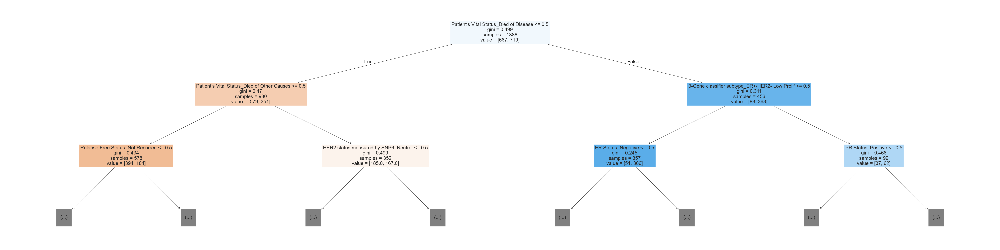

In [382]:
plt.figure(figsize=(80,20))
plot_tree(model, feature_names=X_train.columns, max_depth=2, filled=True);

How a Decision Tree is Created

Note the gini value in each box. This is the loss function used by the decision tree to decide which column should be used for splitting the data, and at what point the column should be split. A lower Gini index indicates a better split. A perfect split (only one class on each side) has a Gini index of 0.
Conceptually speaking, while training the models evaluates all possible splits across all possible columns and picks the best one. Then, it recursively performs an optimal split for the two portions. In practice, however, it's very inefficient to check all possible splits, so the model uses a heuristic (predefined strategy) combined with some randomization.
The iterative approach of the machine learning workflow in the case of a decision tree involves growing the tree layer-by-layer

In [383]:
tree_text = export_text(model, max_depth=10, feature_names=list(X_train.columns))
print(tree_text[:5000])

|--- Patient's Vital Status_Died of Disease <= 0.50
|   |--- Patient's Vital Status_Died of Other Causes <= 0.50
|   |   |--- Relapse Free Status_Not Recurred <= 0.50
|   |   |   |--- 3-Gene classifier subtype_ER+/HER2- High Prolif <= 0.50
|   |   |   |   |--- class: 0
|   |   |   |--- 3-Gene classifier subtype_ER+/HER2- High Prolif >  0.50
|   |   |   |   |--- Pam50 + Claudin-low subtype_LumA <= 0.50
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- Pam50 + Claudin-low subtype_LumA >  0.50
|   |   |   |   |   |--- Cancer Type Detailed_Breast Mixed Ductal and Lobular Carcinoma <= 0.50
|   |   |   |   |   |   |--- Hormone Therapy_Yes <= 0.50
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- Hormone Therapy_Yes >  0.50
|   |   |   |   |   |   |   |--- Primary Tumor Laterality_Right <= 0.50
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- Primary Tumor Laterality_Right >  0.50
|   |   |   |   |   |   |   |   |--- Integrative Cluster_

Feature Importance
Based on the gini index computations, a decision tree assigns an "importance" value to each feature. These values can be used to interpret the results given by a decision tree.

In [384]:
model.feature_importances_

array([0.02292044, 0.01354332, 0.        , 0.        , 0.        ,
       0.0004656 , 0.        , 0.00487176, 0.0015007 , 0.        ,
       0.00417575, 0.00835797, 0.        , 0.03143263, 0.02109861,
       0.02483905, 0.        , 0.01556492, 0.00868475, 0.        ,
       0.01071549, 0.0167876 , 0.03476673, 0.01508016, 0.        ,
       0.00517283, 0.01097743, 0.        , 0.00985345, 0.01372486,
       0.        , 0.00329387, 0.0054025 , 0.00795194, 0.00670271,
       0.01310731, 0.        , 0.        , 0.00424482, 0.00578105,
       0.        , 0.00566635, 0.01010326, 0.00250914, 0.        ,
       0.01212344, 0.00544483, 0.        , 0.0026621 , 0.        ,
       0.02217008, 0.01640806, 0.        , 0.024086  , 0.0123923 ,
       0.        , 0.00900761, 0.00349168, 0.01002497, 0.01189995,
       0.0169212 , 0.00724376, 0.00804869, 0.01078488, 0.02109954,
       0.02668428, 0.01277314, 0.        , 0.02754952, 0.02968848,
       0.        , 0.00432295, 0.0023952 , 0.0080004 , 0.00678

In [385]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [386]:
importance_df.head(10)

,feature,importance
93,Patient's Vital Status_Died of Disease,0.169485
22,Pam50 + Claudin-low subtype_LumA,0.034767
13,Cellularity_High,0.031433
69,Primary Tumor Laterality_Right,0.029688
85,Relapse Free Status_Not Recurred,0.029631
68,Primary Tumor Laterality_Left,0.027550
65,Integrative Cluster_8,0.026684
89,3-Gene classifier subtype_ER+/HER2- Low Prolif,0.025239
15,Cellularity_Moderate,0.024839
53,Inferred Menopausal State_Post,0.024086


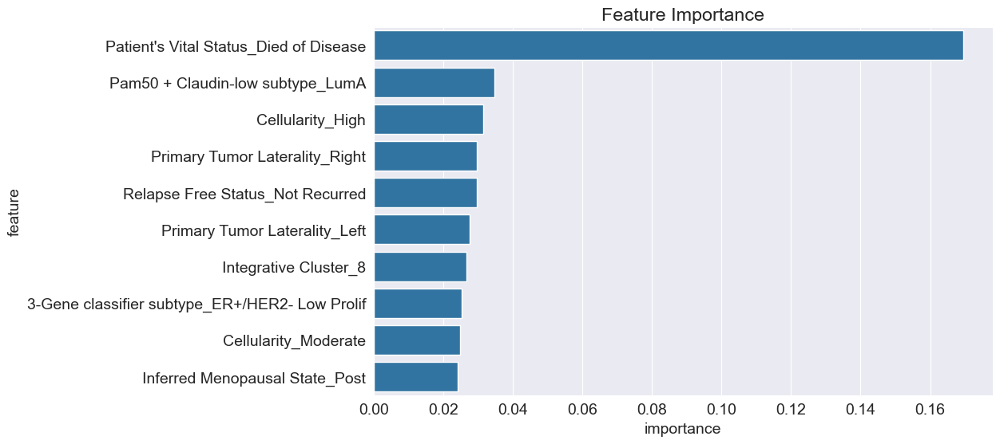

In [400]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

Hyperparameter Tuning and Overfitting
As we see in the previous section, our decision tree classifier memorized all training examples, leading to a 100% training accuracy, while the validation accuracy was only marginally better than a dumb baseline model. This phenomenon is called overfitting, and in this section, we'll look at some strategies for reducing overfitting.

The DecisionTreeClassifier accepts several arguments, some of which can be modified to reduce overfitting.

In [401]:
?DecisionTreeClassifier

Init signature:
DecisionTreeClassifier(
    *,
    criterion='gini',
    splitter='best',
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    min_weight_fraction_leaf=0.0,
    max_features=None,
    random_state=None,
    max_leaf_nodes=None,
    min_impurity_decrease=0.0,
    class_weight=None,
    ccp_alpha=0.0,
    monotonic_cst=None,
)
Docstring:     
A decision tree classifier.

Read more in the :ref:`User Guide <tree>`.

Parameters
----------
criterion : {"gini", "entropy", "log_loss"}, default="gini"
    The function to measure the quality of a split. Supported criteria are
    "gini" for the Gini impurity and "log_loss" and "entropy" both for the
    Shannon information gain, see :ref:`tree_mathematical_formulation`.

splitter : {"best", "random"}, default="best"
    The strategy used to choose the split at each node. Supported
    strategies are "best" to choose the best split and "random" to choose
    the best random split.

max_depth : int, default=None

In [402]:
model = DecisionTreeClassifier(max_depth=3, random_state=42)

In [403]:
model.fit(X_train, train_targets)

DecisionTreeClassifier(max_depth=3, random_state=42)

In [404]:
model.score(X_train, train_targets)

0.6948051948051948

In [405]:
model.score(X_val, val_targets)

0.6363636363636364

In [406]:
model.classes_

array([0, 1])

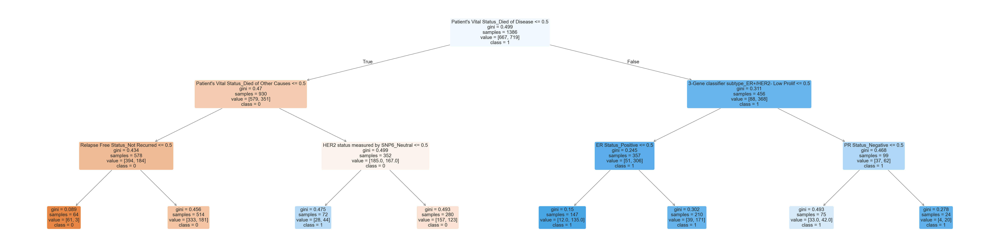

In [408]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

plt.figure(figsize=(80,20))  # Reduce size if needed
plot_tree(model, feature_names=X_train.columns, filled=True, rounded=True, class_names=[str(c) for c in model.classes_]);
plt.show()

In [409]:
print(export_text(model, feature_names=list(X_train.columns)))

|--- Patient's Vital Status_Died of Disease <= 0.50
|   |--- Patient's Vital Status_Died of Other Causes <= 0.50
|   |   |--- Relapse Free Status_Not Recurred <= 0.50
|   |   |   |--- class: 0
|   |   |--- Relapse Free Status_Not Recurred >  0.50
|   |   |   |--- class: 0
|   |--- Patient's Vital Status_Died of Other Causes >  0.50
|   |   |--- HER2 status measured by SNP6_Neutral <= 0.50
|   |   |   |--- class: 1
|   |   |--- HER2 status measured by SNP6_Neutral >  0.50
|   |   |   |--- class: 0
|--- Patient's Vital Status_Died of Disease >  0.50
|   |--- 3-Gene classifier subtype_ER+/HER2- Low Prolif <= 0.50
|   |   |--- ER Status_Positive <= 0.50
|   |   |   |--- class: 1
|   |   |--- ER Status_Positive >  0.50
|   |   |   |--- class: 1
|   |--- 3-Gene classifier subtype_ER+/HER2- Low Prolif >  0.50
|   |   |--- PR Status_Negative <= 0.50
|   |   |   |--- class: 1
|   |   |--- PR Status_Negative >  0.50
|   |   |   |--- class: 1



In [410]:
#Let's experiment with different depths using a helper function.
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth=md, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    val_acc = 1 - model.score(X_val, val_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Validation Error': val_acc}

In [411]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])
errors_df

CPU times: total: 656 ms
Wall time: 702 ms


,Max Depth,Training Error,Validation Error
0,1,0.316739,0.380471
1,2,0.316739,0.380471
2,3,0.305195,0.363636
3,4,0.295094,0.356902
4,5,0.276335,0.383838
5,6,0.258297,0.377104
6,7,0.238095,0.387205
7,8,0.210678,0.367003
8,9,0.180375,0.400673
9,10,0.155123,0.387205


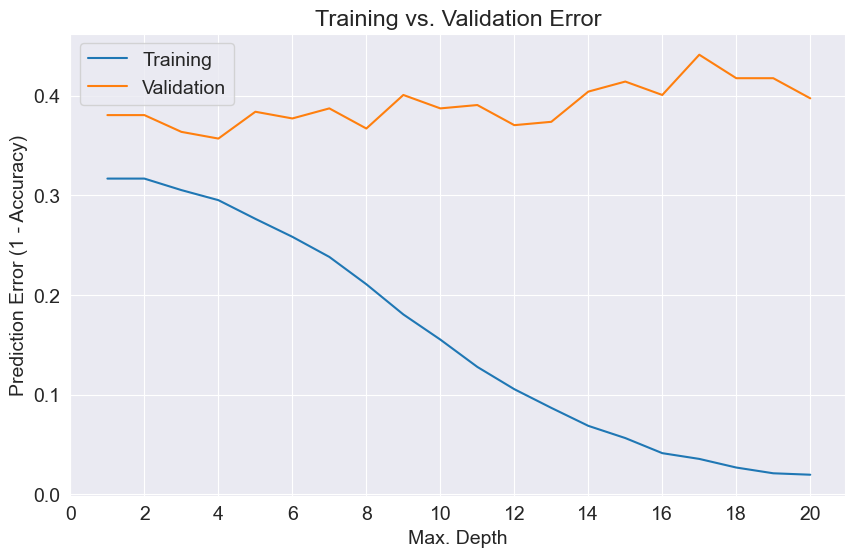

In [412]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Validation Error'])
plt.title('Training vs. Validation Error')
plt.xticks(range(0,21, 2))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

In [413]:
#You'll often need to tune hyperparameters carefully to find the optimal fit. In the above case, it appears that a maximum depth of 7 results in the lowest validation error.

model = DecisionTreeClassifier(max_depth=7, random_state=42).fit(X_train, train_targets)
model.score(X_val, val_targets)

0.6127946127946128

max_leaf_nodes
Another way to control the size of complexity of a decision tree is to limit the number of leaf nodes. This allows branches of the tree to have varying depths.

In [414]:
model = DecisionTreeClassifier(max_leaf_nodes=128, random_state=42)
model.fit(X_train, train_targets)
model.score(X_train, train_targets)
model.score(X_val, val_targets)
model.tree_.max_depth

15

In [415]:
model_text = export_text(model, feature_names=list(X_train.columns))
print(model_text[:3000])

|--- Patient's Vital Status_Died of Disease <= 0.50
|   |--- Patient's Vital Status_Died of Other Causes <= 0.50
|   |   |--- Relapse Free Status_Not Recurred <= 0.50
|   |   |   |--- class: 0
|   |   |--- Relapse Free Status_Not Recurred >  0.50
|   |   |   |--- Integrative Cluster_4ER+ <= 0.50
|   |   |   |   |--- Hormone Therapy_No <= 0.50
|   |   |   |   |   |--- ER status measured by IHC_Positve <= 0.50
|   |   |   |   |   |   |--- Cellularity_Low <= 0.50
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- Cellularity_Low >  0.50
|   |   |   |   |   |   |   |--- Primary Tumor Laterality_Right <= 0.50
|   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- Primary Tumor Laterality_Right >  0.50
|   |   |   |   |   |   |   |   |--- Chemotherapy_Yes <= 0.50
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |--- Chemotherapy_Yes >  0.50
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- E

Training a Random Forest
While tuning the hyperparameters of a single decision tree may lead to some improvements, a much more effective strategy is to combine the results of several decision trees trained with slightly different parameters. This is called a random forest.

The key idea here is that each decision tree in the forest will make different kinds of errors, and upon averaging, many of their errors will cancel out. This idea is also known as the "wisdom of the crowd" in common parlance:



In [419]:
#We'll use the RandomForestClassifier class from sklearn.ensemble.

from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_jobs=-1, random_state=42)


In [421]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 1.05 s
Wall time: 510 ms


RandomForestClassifier(n_jobs=-1, random_state=42)

In [422]:
model.score(X_train, train_targets)

0.9826839826839827

In [423]:
model.score(X_val, val_targets)

0.6060606060606061

In [424]:
train_probs = model.predict_proba(X_train)
train_probs

array([[0.91, 0.09],
       [0.2 , 0.8 ],
       [0.85, 0.15],
       ...,
       [0.02, 0.98],
       [0.02, 0.98],
       [0.87, 0.13]], shape=(1386, 2))

In [425]:
model.estimators_[0]

DecisionTreeClassifier(max_features='sqrt', random_state=1608637542)

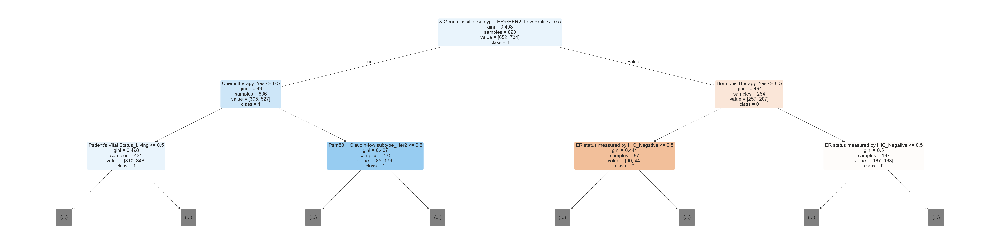

In [427]:
plt.figure(figsize=(80, 20))
plot_tree(model.estimators_[0], 
          max_depth=2, 
          feature_names=X_train.columns, 
          filled=True, 
          rounded=True, 
          class_names=[str(c) for c in model.classes_]);  # Convert class names to strings
plt.show()


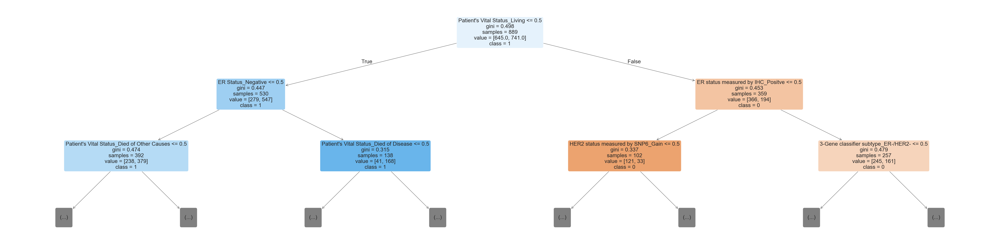

In [428]:
plt.figure(figsize=(80, 20))
plot_tree(model.estimators_[15], 
          max_depth=2, 
          feature_names=X_train.columns, 
          filled=True, 
          rounded=True, 
          class_names=[str(c) for c in model.classes_]);  # Convert class names to strings
plt.show()

Just like decision tree, random forests also assign an "importance" to each feature, by combining the importance values from individual trees.

In [429]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [430]:
importance_df.head(10)

,feature,importance
95,Patient's Vital Status_Living,0.059518
93,Patient's Vital Status_Died of Disease,0.054299
86,Relapse Free Status_Recurred,0.033584
85,Relapse Free Status_Not Recurred,0.029906
13,Cellularity_High,0.029494
15,Cellularity_Moderate,0.027983
69,Primary Tumor Laterality_Right,0.027087
68,Primary Tumor Laterality_Left,0.026591
89,3-Gene classifier subtype_ER+/HER2- Low Prolif,0.023944
1,Type of Breast Surgery_Mastectomy,0.023787


Hyperparameter Tuning with Random Forests
Just like decision trees, random forests also have several hyperparameters. In fact many of these hyperparameters are applied to the underlying decision trees.

In [431]:
?RandomForestClassifier

Init signature:
RandomForestClassifier(
    n_estimators=100,
    *,
    criterion='gini',
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    min_weight_fraction_leaf=0.0,
    max_features='sqrt',
    max_leaf_nodes=None,
    min_impurity_decrease=0.0,
    bootstrap=True,
    oob_score=False,
    n_jobs=None,
    random_state=None,
    verbose=0,
    warm_start=False,
    class_weight=None,
    ccp_alpha=0.0,
    max_samples=None,
    monotonic_cst=None,
)
Docstring:     
A random forest classifier.

A random forest is a meta estimator that fits a number of decision tree
classifiers on various sub-samples of the dataset and uses averaging to
improve the predictive accuracy and control over-fitting.
Trees in the forest use the best split strategy, i.e. equivalent to passing
`splitter="best"` to the underlying :class:`~sklearn.tree.DecisionTreeClassifier`.
The sub-sample size is controlled with the `max_samples` parameter if
`bootstrap=True` (default), otherwise the

In [432]:
base_model = RandomForestClassifier(random_state=42, n_jobs=-1).fit(X_train, train_targets)

In [433]:
base_train_acc = base_model.score(X_train, train_targets)
base_val_acc = base_model.score(X_val, val_targets)

In [434]:
base_accs = base_train_acc, base_val_acc
base_accs

(0.9826839826839827, 0.6060606060606061)

n_estimators
This controls the number of decision trees in the random forest. The default value is 100. For larger datasets, it helps to have a greater number of estimators. As a general rule, try to have as few estimators as needed.

10 estimators

In [435]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=10)

In [436]:
model.fit(X_train, train_targets)

RandomForestClassifier(n_estimators=10, n_jobs=-1, random_state=42)

In [437]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9660894660894661, 0.6195286195286195)

In [438]:
base_accs

(0.9826839826839827, 0.6060606060606061)

In [439]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=500)
model.fit(X_train, train_targets)

RandomForestClassifier(n_estimators=500, n_jobs=-1, random_state=42)

In [440]:
model.score(X_train, train_targets)

0.9826839826839827

In [441]:
model.score(X_val, val_targets)

0.6397306397306397

In [442]:
base_accs

(0.9826839826839827, 0.6060606060606061)

In [449]:
model.set_params(max_features='log2')


RandomForestClassifier(class_weight={0, 1}, max_depth=30, max_features='log2',
                       n_estimators=500, n_jobs=-1, random_state=42)

In [451]:
model.set_params(max_features=3)

RandomForestClassifier(class_weight={0, 1}, max_depth=30, max_features=3,
                       n_estimators=500, n_jobs=-1, random_state=42)

In [452]:
model.set_params(max_features=6)

RandomForestClassifier(class_weight={0, 1}, max_depth=30, max_features=6,
                       n_estimators=500, n_jobs=-1, random_state=42)

In [453]:
base_accs

(0.9826839826839827, 0.6060606060606061)

In [454]:
def test_params(**params):
    model = RandomForestClassifier(random_state=42, n_jobs=-1, **params).fit(X_train, train_targets)
    return model.score(X_train, train_targets), model.score(X_val, val_targets)

In [455]:
test_params(max_depth=5)

(0.7243867243867244, 0.6498316498316499)

In [456]:
test_params(max_depth=25)

(0.9826839826839827, 0.6060606060606061)

In [457]:
test_params(max_leaf_nodes=2**5)

(0.7525252525252525, 0.6296296296296297)

In [458]:
base_accs # no max depth or max leaf nodes

(0.9826839826839827, 0.6060606060606061)

In [459]:
#min_samples_split and min_samples_leaf
#By default, the decision tree classifier tries to split every node that has 2 or more. You can increase the values of these arguments to change this behavior and reduce overfitting, especially for very large datasets.

test_params(min_samples_split=3, min_samples_leaf=2)
test_params(min_samples_split=100, min_samples_leaf=60)

(0.6861471861471862, 0.6060606060606061)

In [460]:
base_accs

(0.9826839826839827, 0.6060606060606061)

In [461]:
#min_impurity_decrease
#This argument is used to control the threshold for splitting nodes. A node will be split if this split induces a decrease of the impurity (Gini index) greater than or equal to this value. It's default value is 0, and you can increase it to reduce overfitting.

test_params(min_impurity_decrease=1e-6)
test_params(min_impurity_decrease=1e-2)
base_accs

(0.9826839826839827, 0.6060606060606061)

In [462]:
model = RandomForestClassifier(
    n_jobs=-1, 
    random_state=42, 
    n_estimators=500,
    max_features=7,
    max_depth=30, 
    class_weight={0: 1, 1: 1.5}  # Adjusted class weights for 0 and 1
)


In [463]:
model.fit(X_train, train_targets)

RandomForestClassifier(class_weight={0: 1, 1: 1.5}, max_depth=30,
                       max_features=7, n_estimators=500, n_jobs=-1,
                       random_state=42)

In [464]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9826839826839827, 0.6195286195286195)

In [466]:
base_accs

(0.9826839826839827, 0.6060606060606061)

Depending on the dataset, you may or may not a see a significant improvement with hyperparameter tuning. This could be due to any of the following reasons:There simply may not be enough signal in the dataset.

In [472]:
def predict_input(single_input):
    input_df = pd.DataFrame([single_input])
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = model.predict(X_input)[0]
    prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
    return pred, prob

In [473]:
new_input = {'Patient ID': 'MB-0185',
             'Age at Diagnosis': 27,
             'Type of Breast Surgery': 'Mastectomy',
             'Cancer Type': 'Breast Cancer',
             'Cancer Type Detailed': 'Breast Mixed Ductal and Lobular Carcinoma',
             'Cellularity': 'High',
             'Chemotherapy': 'Yes',
             'Pam50 + Claudin-low subtype': 'LumB',
             'Cohort': 5,
             'ER status measured by IHC': 'Negative',
             'ER Status': 'Negative',
             'Neoplasm Histologic Grade': 3,
             'HER2 status measured by SNP6': 'Neutral',
             'HER2 Status': 'Negative',
             'Tumor Other Histologic Subtype': 'Lobular',
             'Hormone Therapy': 'Yes',
             'Inferred Menopausal State': 'Pre',
             'Integrative Cluster': '4ER+',
             'Primary Tumor Laterality': 'Left',
             'Lymph nodes examined positive': 0,
             'Mutation Count': 3,
             'Nottingham prognostic index': 4.058,
             'Oncotree Code': 'ILC',
             'PR Status' : 'Positive',
             'Radio Therapy': 'Yes',
             'Relapse Free Status (Months)': 162.17,
             'Relapse Free Status':'Not Recurred',
             '3-Gene classifier subtype': 'ER-/HER2-',
             'Tumor Size': 30,
             'Tumor Stage':2,
             "Patient's Vital Status":'Living'}